In this notebook we cross-identify COSMOLOGY 22 sources in P, I, and optical. First we'll load up the P components and I components. These were generated with Aegean and the P components were filtered by whether they were within $\sim 60''$ (twice the beam) of a Stokes I component.

In [446]:
from io import BytesIO
import multiprocessing.pool
import warnings

import altair as alt
from astropy.coordinates import SkyCoord as SC
from astropy.io import fits
from astropy.nddata import Cutout2D
from astropy.wcs import WCS
import astropy.units as u
import astroquery.vo_conesearch.conesearch as conesearch
import grequests
from IPython import display
import numpy
import pandas
from PIL import Image
import pyvo
import requests
import scipy.stats.distributions
import scipy.optimize as opt
from tqdm import tqdm

alt.data_transformers.enable('json')

DataTransformerRegistry.enable('json')

In [3]:
components_P = pandas.read_csv('p_component_validation.csv')
components_I = pandas.read_csv('/home/alger/possum/alger/COSMOLOGY_22/i_catalogue_comp.csv')

We can get SkyMapper objects with its VO interface. We'll start with a simple positional match as for P.

In [4]:
SKYMAPPER_URL = 'http://skymapper.anu.edu.au/sm-cone/aus/query'
search_radius = 120 * u.arcsec
search_verb = 3

In [6]:
refetch_skymapper = False

if refetch_skymapper:
    matches = []
    bar = tqdm(total=len(components_I))
    for component in components_I.itertuples():
        coord = SC(ra=component.ra, dec=component.dec, unit=u.deg)
        with warnings.catch_warnings():
            warnings.filterwarnings('ignore', message=r'.*W03')
            try:
                skymapper_query_result = conesearch.conesearch(
                    coord, radius=search_radius, verb=search_verb, catalog_db=SKYMAPPER_URL, verbose=False, cache=False
                    ).to_table().to_pandas()
            except conesearch.VOSError:
                raise
        matches.append(skymapper_query_result.iloc[0])
        bar.update(1)

    matches = pandas.DataFrame(matches)

    matches['index_I'] = range(len(components_I))

    matches.set_index('index_I', inplace=True)

    components_I = components_I.join(matches, rsuffix='_sm')

    components = components_I.merge(components_P, how='left', suffixes=('_i', '_p'), left_index=True, right_on='index')

    components.to_csv('pm_cross_id.csv')
else:
    components = pandas.read_csv('pm_cross_id.csv')

We now have a preliminary cross-id catalogue. Let's make a simple scoring function based on the separation distributions between SkyMapper and I. The distributions fit an exponential-Rayleigh mixture model fairly well (this is what we expect with a constant sky density).

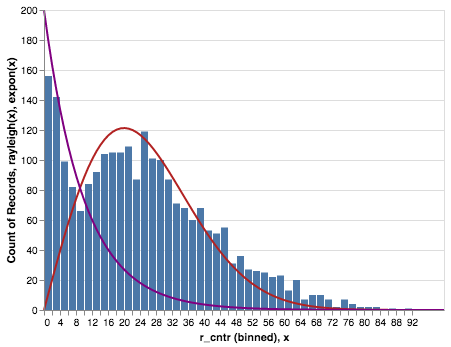

In [7]:
separation_histogram = alt.Chart(components.apply(pandas.to_numeric, errors='coerce')).mark_bar().encode(
    x=alt.X('r_cntr', bin=alt.Bin(maxbins=50)),
    y='count()',
)
x = numpy.linspace(0, 100, 100)
df = pandas.DataFrame({
    'x': x,
    'rayleigh(x)': scipy.stats.distributions.rayleigh.pdf(x, 0, 20) * 4e3,
    'expon(x)': scipy.stats.distributions.expon.pdf(x, 0, 10) * 2e3,
})
rayleigh = alt.Chart(df).mark_line(color='firebrick').encode(x='x', y='rayleigh(x)')
expon = alt.Chart(df).mark_line(color='purple').encode(x='x', y='expon(x)')

separation_histogram + rayleigh + expon

We can fit these parameters with scipy.

In [8]:
binned_y, binned_x = numpy.histogram(components.r_cntr, bins=50)
def mixture_model(x, rayleigh_scale, rayleigh_weight, expon_scale, expon_weight):
    rayleigh = scipy.stats.distributions.rayleigh.pdf(x, 0, rayleigh_scale) * rayleigh_weight
    expon = scipy.stats.distributions.expon.pdf(x, 0, expon_scale) * expon_weight
    return rayleigh + expon

popt, *_ = opt.curve_fit(mixture_model, (binned_x[:-1] + binned_x[1:]) / 2, binned_y, p0=[20, 4e3, 10, 2e3])

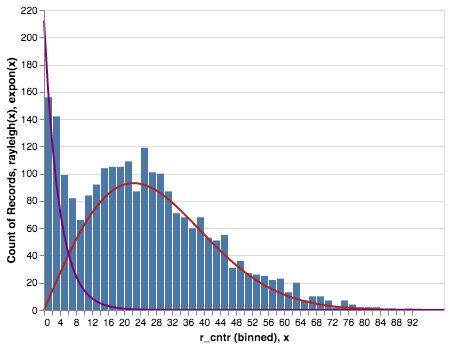

In [9]:
df = pandas.DataFrame({
    'x': x,
    'rayleigh(x)': scipy.stats.distributions.rayleigh.pdf(x, 0, popt[0]) * popt[1],
    'expon(x)': scipy.stats.distributions.expon.pdf(x, 0, popt[2]) * popt[3],
})
rayleigh = alt.Chart(df).mark_line(color='firebrick').encode(x='x', y='rayleigh(x)')
expon = alt.Chart(df).mark_line(color='purple').encode(x='x', y='expon(x)')

separation_histogram + rayleigh + expon

The score of a separation is the probability it's drawn from the exponential rather than the Rayleigh.

In [466]:
def score(separation, rayleigh_scale, rayleigh_weight, expon_scale, expon_weight):
    total_weight = rayleigh_weight + expon_weight
    rayleigh_weight, expon_weight = rayleigh_weight / total_weight, expon_weight / total_weight
    rayleigh = scipy.stats.distributions.rayleigh.pdf(separation, 0, rayleigh_scale) * rayleigh_weight
    expon = scipy.stats.distributions.expon.pdf(separation, 0, expon_scale) * expon_weight
    return expon / (rayleigh + expon)

In [467]:
scores = score(components.r_cntr, *popt)

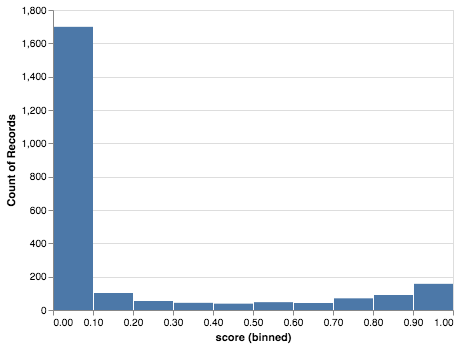

In [468]:
alt.Chart(pandas.DataFrame({'score': scores, 'seps': components.r_cntr})
         ).mark_bar().encode(
    alt.X('score', bin=True),
    alt.Y('count()'))

Most cross-IDs are low probability according to this scoring function. Let's sort the components by score and look at them. We'll start by looking at the top few and bottom few to validate our scoring method.

In [456]:
I = fits.open(
    '/home/alger/possum/alger/COSMOLOGY_22/image.i.SB5127.cont.restored.fits',
     mode='denywrite')
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    wcs = WCS(I[0].header).dropaxis(3).dropaxis(2)

def view_cross_id(coords, host_coords, others=None, radius=3 * u.arcmin):
    cutout = Cutout2D(I[0].data[0, 0], coords, radius, wcs=wcs)
    df = pandas.DataFrame(numpy.arcsinh(cutout.data / numpy.nanmax(abs(cutout.data)) / 1e-1))
    melted = df.melt(var_name='y').rename_axis('x').reset_index()
    melted.x = melted.x % cutout.shape[0]
    chart = alt.Chart(melted).mark_rect().encode(
        alt.X('x:Q', bin=alt.Bin(step=1)),
        alt.Y('y:Q', bin=alt.Bin(step=1)),
        alt.Color('value:Q', scale=alt.Scale(scheme='purpleblue')))

    df = pandas.DataFrame(cutout.wcs.all_world2pix([[host_coords.ra.deg, host_coords.dec.deg]], 1))
    host = alt.Chart(df).mark_point(color='black', size=50).encode(
        x='0:Q', y='1:Q')
    if others:
        df = pandas.DataFrame(cutout.wcs.all_world2pix([[c.ra.deg, c.dec.deg] for c in others], 1))
        others = alt.Chart(df).mark_point(color='grey', size=50).encode(
            x='0:Q', y='1:Q')
        return chart + others + host
    return chart + host

In [351]:
score_sorted_components = components.copy()
score_sorted_components['score'] = scores

In [352]:
score_sorted_components.sort_values('score', inplace=True, ascending=False)

Here's the top scores:

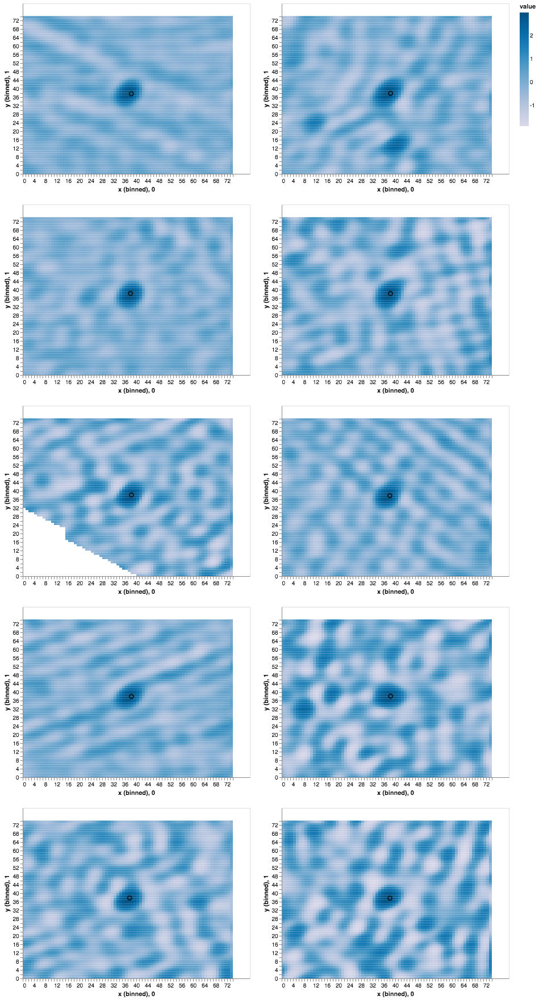

In [357]:
charts = []
for i in range(10):
    charts.append(view_cross_id(
        SC(ra=score_sorted_components.ra_i.iloc[i], dec=score_sorted_components.dec_i.iloc[i], unit=u.deg),
        SC(ra=score_sorted_components.raj2000.iloc[i], dec=score_sorted_components.dej2000.iloc[i], unit=u.deg),
        radius=5*u.arcmin))

alt.vconcat(*charts[1::2]) | alt.vconcat(*charts[::2])

And the bottom:

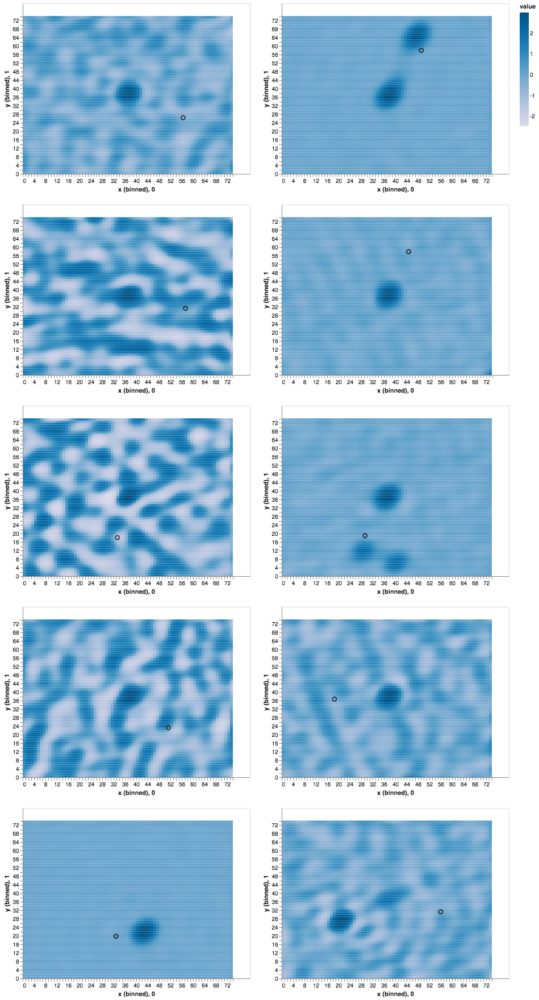

In [469]:
charts = []
for i in range(10):
    i = len(score_sorted_components) - i - 1
    charts.append(view_cross_id(
        SC(ra=score_sorted_components.ra_i.iloc[i], dec=score_sorted_components.dec_i.iloc[i], unit=u.deg),
        SC(ra=score_sorted_components.raj2000.iloc[i], dec=score_sorted_components.dej2000.iloc[i], unit=u.deg),
        radius=5*u.arcmin))

alt.vconcat(*charts[1::2]) | alt.vconcat(*charts[::2])

This seems a good metric. SkyMapper also has a stellarity index like SWIRE, so we can check whether we have lots of star-like objects or very few. We expect few, though we could have QSOs as well — so we won't filter on stars.

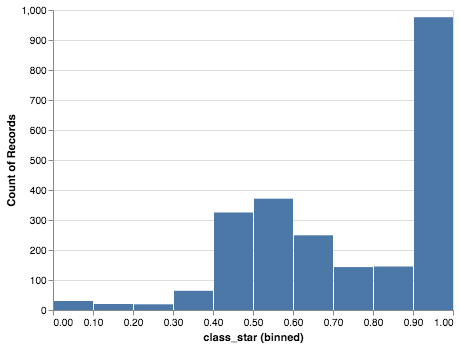

In [470]:
alt.Chart(score_sorted_components).mark_bar().encode(alt.X('class_star', bin=True), y='count()')

Lots of candidate hosts are star-like. Now let's validate.

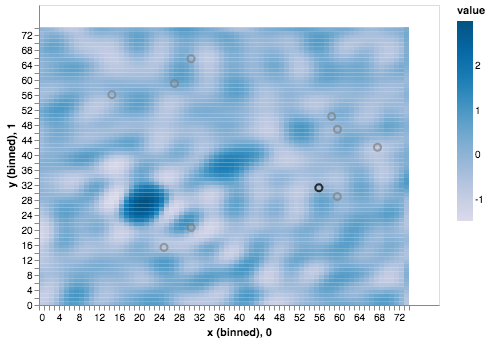

KeyboardInterrupt: 

In [471]:
# This cell lets you flag cross-IDs as real or not.
res = {'y': [], 'n': [], 'u': []}
for i, (k, obj) in enumerate(score_sorted_components[::-1].iterrows()):
    # Get the SkyMapper candidates.
    coord = SC(ra=obj.ra_i, dec=obj.dec_i, unit=u.deg)
    with warnings.catch_warnings():
        warnings.filterwarnings('ignore', message=r'.*W03')
        try:
            skymapper_query_result = conesearch.conesearch(
                coord, radius=search_radius, verb=search_verb, catalog_db=SKYMAPPER_URL, verbose=False, cache=False
                ).to_table().to_pandas()
        except conesearch.VOSError:
            raise
    match_coords = SC(ra=skymapper_query_result['raj2000'], dec=skymapper_query_result['dej2000'], unit=u.deg)
    chart = view_cross_id(
        coord,
        SC(ra=obj.raj2000, dec=obj.dej2000, unit=u.deg),
        others=match_coords,
        radius=5*u.arcmin)
    display.display(chart)
    ok = '?'
    while ok not in 'ynu':
        ok = input('{}/{}: ynu> '.format(i + 1, len(score_sorted_components))).lower()
        
    res[ok].append(k)
    
    # Clear the output.
    display.clear_output()

In [ ]:
# This cell lets you flag cross-IDs as real or not.
res = {'y': [], 'n': [], 'u': []}
for i, obj in score_sorted_components.iterrows():
    # Get the SkyMapper candidates.
    coord = SC(ra=obj.ra, dec=obj.dec, unit=u.deg)
    with warnings.catch_warnings():
        warnings.filterwarnings('ignore', message=r'.*W03')
        try:dd
            skymapper_query_result = conesearch.conesearch(
                coord, radius=search_radius, verb=search_verb, catalog_db=SKYMAPPER_URL, verbose=False, cache=False
                ).to_table().to_pandas()
        except conesearch.VOSError:
            raise
    print(skymapper_query_result)
    # Get the cutouts.
    cutout_P = Cutout2D(mean_P, coords_P[match_mask][k], size=4 * units.arcmin, wcs=wcs['Q'])
    cutout_I = Cutout2D(I[0].data[0, 0], coords_P[match_mask][k], size=4 * units.arcmin, wcs=wcs['I'])
    # Plot them.
    fig = plt.figure()
    ax_P = fig.add_subplot(1, 2, 1)
    im_P = ax_P.imshow(cutout_P.data)
    plt.title('P')
    ax_I = fig.add_subplot(1, 2, 2)
    im_I = ax_I.imshow(cutout_I.data)
    plt.title('I')
    plt.tight_layout()
    plt.show()
    ok = '?'
    while ok not in 'ynu':
        ok = input('{}/{}: ynu> '.format(k + 1, sum(match_mask))).lower()
        
    res[ok].append(k)
    
    # Clear the output.
    display.clear_output()